# Aggregate TFIDF

```yaml
course:   DS 5001 
module:   05 5 Lab
topic:    Aggregate TFIDF
author:   R.C. Alvarado
date:     13 February 2024
```

# Overview

Recall Luhn's (1958) representation of the problem:

<img src="luhn.png"/>

In this notebook, we look at ways to approximate Luhn's significance curve using the ideas we learned in this module.

# Set Up

## Import

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly_express as px

In [2]:
sns.set()

## Config

Change this to match the location of your data files.

In [3]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home'] 
output_dir = config['DEFAULT']['output_dir']
data_prefix = 'austen-melville'

In [4]:
OHCO = ['book_id', 'chap_num', 'para_num', 'sent_num', 'token_num']
bags = dict(
    SENTS = OHCO[:4],
    PARAS = OHCO[:3],
    CHAPS = OHCO[:2],
    BOOKS = OHCO[:1]
)

In [48]:
# bag = 'BOOKS'
bag = 'CHAPS'

# Prepare the data

## Import tables

In [152]:
LIB = pd.read_csv(f"{output_dir}/{data_prefix}-LIB.csv").set_index('book_id')
TOKEN = pd.read_csv(f'{output_dir}/{data_prefix}-TOKEN.csv').set_index(OHCO).dropna()
VOCAB = pd.read_csv(f'{output_dir}/{data_prefix}-VOCAB-{bag}.csv').set_index('term_str').dropna()
BOW = pd.read_csv(f'{output_dir}/{data_prefix}-BOW-{bag}.csv').set_index(bags[bag]+['term_str'])
DTCM = pd.read_csv(f'{output_dir}/{data_prefix}-DTCM-{bag}.csv').set_index(bags[bag]) 
TFIDF = pd.read_csv(f'{output_dir}/{data_prefix}-TFIDF-{bag}.csv').set_index(bags[bag])
DOC = pd.read_csv(f'{output_dir}/{data_prefix}-DOC-{bag}.csv').set_index(bags[bag])

Hmmm ...

In [154]:
(VOCAB.df > VOCAB.n).sum()

2295

In [158]:
VOCAB['n2'] = DTCM.sum()

In [175]:
VOCAB['p2'] = VOCAB.n2 / VOCAB.n2.sum()

In [176]:
VOCAB['i2'] = -np.log2(VOCAB.p2)

In [179]:
# VOCAB.plot.scatter('i','i2')

# Apply aggregates to VOCAB

In [166]:
VOCAB['tfidf_mean'] = TFIDF.mean() 
VOCAB['tfidf_sum'] = TFIDF.sum()

## Add DFIDF and DH

Instead of aggregating TFIDF values, try estimating the their weights over documents directly.

Do this in two ways:

1. Based on a variation on the TF-IDF formula.
2. Just estimate the entropy of terms over documents.

In [164]:
VOCAB['dfidf'] = VOCAB.df * VOCAB.idf
VOCAB['dp'] = VOCAB.df / len(DOC)
VOCAB['di'] = np.log2(1/VOCAB.dp)
VOCAB['dh'] = VOCAB.dp * VOCAB.di

## Observe results

In [180]:
VOCAB.sample(25).sort_values('di', ascending=True)[['max_pos', 'n2', 'i2','tfidf_mean','tfidf_sum', 'dfidf', 'di', 'dh']]\
    .style.background_gradient(cmap='YlGnBu')

,max_pos,n2,i2,tfidf_mean,tfidf_sum,dfidf,di,dh
term_str,,,,,,,,
saint,NN,20,16.658716,0.000076,0.085746,107.314775,5.961932,0.095646
climb,VB,20,16.658716,0.000082,0.091485,98.109711,6.131857,0.087442
crystal,NN,13,17.280204,0.000083,0.093681,83.608424,6.431417,0.074517
companies,NNS,12,17.395681,0.000037,0.042044,73.396679,6.672425,0.065416
subtler,NN,8,17.980644,0.000048,0.053984,57.054856,7.131857,0.050851
solved,VBN,6,18.395681,0.000023,0.026039,45.281367,7.546894,0.040358
whiter,JJ,4,18.980644,0.000013,0.014172,32.527428,8.131857,0.028991
contested,VBN,3,19.395681,0.000008,0.009481,25.640683,8.546894,0.022853
alludes,VBZ,3,19.395681,0.000014,0.016266,25.640683,8.546894,0.022853


# Visualize

Try to pick the best aggregate statistic.

## Information and TFIDF Mean 

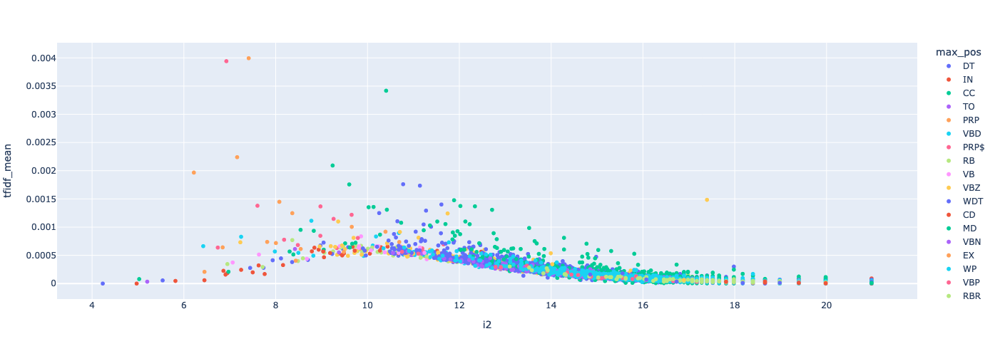

In [181]:
px.scatter(VOCAB.reset_index(), x='i2', y='tfidf_mean', 
           hover_name='term_str', hover_data=['n'], color='max_pos', 
           log_x=False, log_y=False, height=500, width=700)

## Information and TFIDF Sum

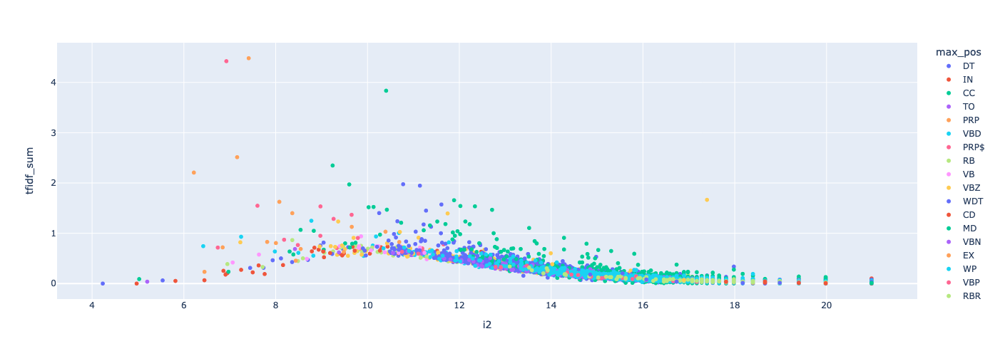

In [182]:
px.scatter(VOCAB.reset_index(), x='i2', y='tfidf_sum', 
           hover_name='term_str', hover_data=['n'], color='max_pos', 
           height=500, width=700)

## Information and DFIDF

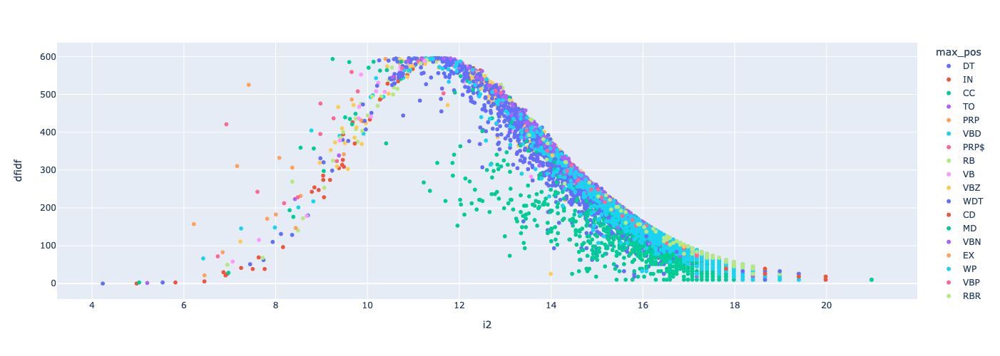

In [183]:
px.scatter(VOCAB.reset_index(), x='i2', y='dfidf', 
           hover_name='term_str', hover_data=['n'], 
           color='max_pos', height=500, width=800)

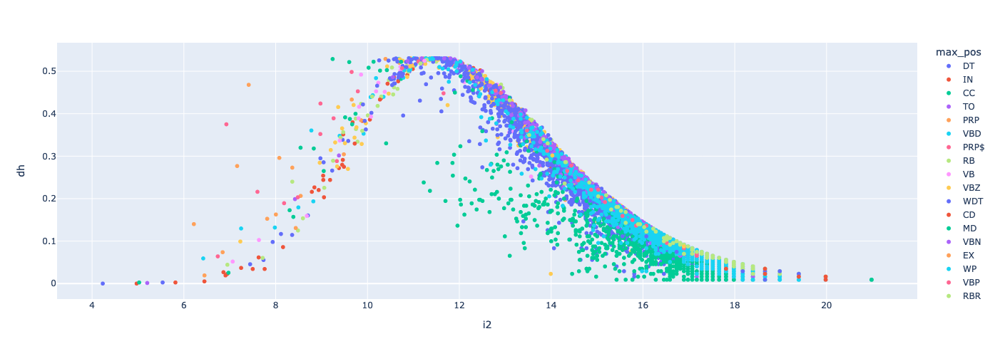

In [184]:
px.scatter(VOCAB.reset_index(), x='i2', y='dh', 
           hover_name='term_str', hover_data=['n'], 
           color='max_pos', height=500, width=800)

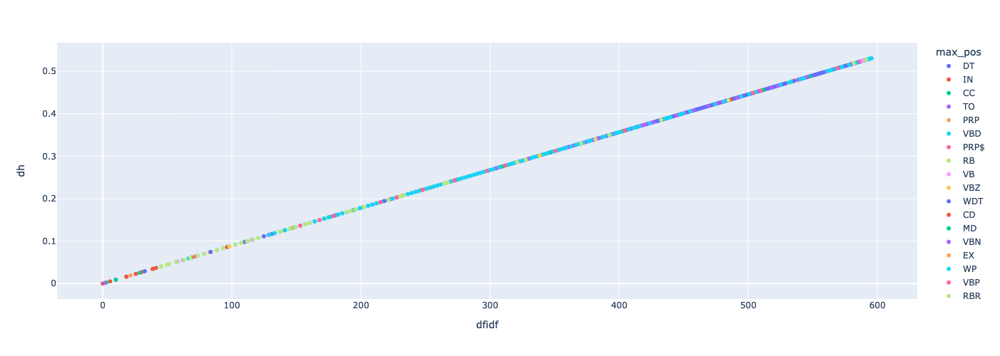

In [187]:
px.scatter(VOCAB.reset_index(), x='dfidf', y='dh', 
           hover_name='term_str', hover_data=['n2'],
           color='max_pos', height=500, width=700)

## Demo Table

In [74]:
rank_index = [1, 2, 3, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000]

In [188]:
demo2 = VOCAB.loc[VOCAB.term_rank.isin(rank_index), 
                  ['max_pos', 'i2', 'tfidf_mean', 'tfidf_sum', 'dfidf', 'dh']]

In [189]:
demo2.style.background_gradient(cmap='YlGnBu')

,max_pos,i2,tfidf_mean,tfidf_sum,dfidf,dh
term_str,,,,,,
the,DT,4.232281,0.000000,0.000000,0.000000,0.000000
of,IN,4.970618,0.000000,0.000000,0.000000,0.000000
and,CC,5.025539,0.000079,0.088788,2.882817,0.002569
it,PRP,6.448227,0.000208,0.233208,21.495121,0.019158
you,PRP,7.160265,0.002240,2.513699,310.618692,0.276844
so,RB,7.715761,0.000293,0.329229,67.746505,0.060380
their,PRP$,8.183388,0.000777,0.871750,212.307769,0.189223
are,VBP,8.482293,0.000683,0.766291,228.069595,0.203271
will,MD,8.829627,0.000935,1.049116,356.913125,0.318104


# Reduce VOCAB

## Select Significant Terms based on DFIDF

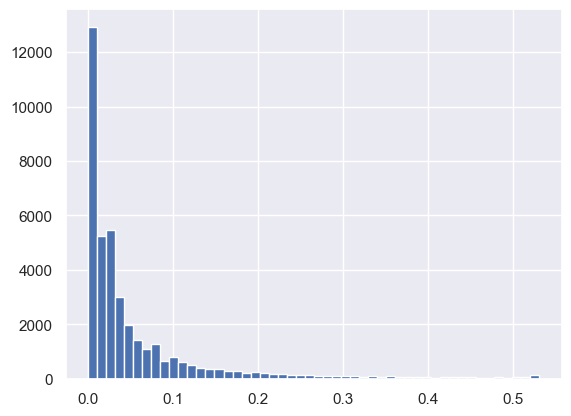

In [199]:
VOCAB.dh.hist(bins=50);

In [196]:
SIGS = VOCAB.sort_values('dh', ascending=False).head(4000)

In [225]:
SIGS[['max_pos', 'n2', 'i2', 'dh']].head(25).style.background_gradient(cmap='YlGnBu')

,max_pos,n2,i2,dh
term_str,,,,
hands,NNS,764,11.403215,0.530737
sure,JJ,1059,10.932157,0.530737
short,JJ,700,11.529433,0.530735
new,JJ,786,11.362258,0.530726
word,NN,709,11.511002,0.530726
passed,VBN,689,11.552284,0.530722
fine,JJ,743,11.443425,0.530716
name,NN,731,11.466916,0.530710
sight,NN,684,11.562791,0.530702


# Save Work

In [226]:
save_path = f"{output_dir}/{data_prefix}"
# VOCAB.to_csv(f'{save_path}-VOCAB-{bag}.csv')
# TOKEN.to_csv(f'{save_path}-TOKEN2.csv')
# BOW.to_csv(f'{save_path}-BOW-{bag}.csv')
# DTCM.to_csv(f'{save_path}-DTCM-{bag}.csv')
# TFIDF.to_csv(f'{save_path}-TFIDF-{bag}.csv')
SIGS.to_csv(f'{save_path}-SIGS-{bag}.csv')
TFIDF[SIGS.index].to_csv(f'{save_path}-TFIDF_REDUCED-{bag}.csv')
# DOC.to_csv(f'{save_path}-CHAP_STATS.csv')